Word2Vec# VINCENT VAN GOGH STANDARD DATA TEXT PROCESS

This script takes the gallery's text from the local data folder and process it to an standard representation with Natural Language Processing and Word2Vec methods.

The process goes as follows:

1. Load the CSV into a pandas DataFrame.
2. Transform text columns into words lists.
3. Clear the text to find tokens (remove stop words).
4. Save corpus complete dictionary.
4. Lemmatize the tokens to find stem words.
5. Execute Bag of Words to find vector representation (doc2bow).
6. Execute the mapping of tokens in the text to find vector representation (doc2idx).
7. Execute the Word 2 Vect standarization process with tf-idf method (TF-IDF: Term Frequency - Inverse Document Frequency).
8. Create the dense standard vector text representation.
9. Save the the resulting CSV from pandas DataFrame

The following Links were useful to create this proof of concept:

- Gensim Word2Vec Tutorial, URL: https://www.kaggle.com/pierremegret/gensim-word2vec-tutorial#Getting-Started
- Gensim Core Concepts, URL: https://radimrehurek.com/gensim/auto_examples/core/run_core_concepts.html
- Document similarity queries, URL: https://radimrehurek.com/gensim/similarities/docsim.html
- Tutorial 19: Text analysis with gensim, URL: https://statsmaths.github.io/stat289-f18/solutions/tutorial19-gensim.html
- Gensim TF-IDF model, URL: https://radimrehurek.com/gensim/models/tfidfmodel.html?highlight=tfidfmodel#module-gensim.models.tfidfmodel
- Gensim, Construct word<->id mappings, URL: https://radimrehurek.com/gensim/corpora/dictionary.html?highlight=doc2idx#gensim.corpora.dictionary.Dictionary.doc2idx
- tensorflow, Word2Vec, URL: https://www.tensorflow.org/tutorials/text/word2vec
- Introduction to Word Embeddings, URL: https://pub.towardsai.net/introduction-to-word-embedding-5ba5cf97d296
- Python for NLP: Working with the Gensim Library (Part 1), URL: https://stackabuse.com/python-for-nlp-working-with-the-gensim-library-part-1/
- Packt main github repository, URL: https://github.com/PacktPublishing
- Regex Complement, URL: https://stackoverflow.com/questions/3977455/how-do-i-turn-any-regex-into-an-complement-of-itself-without-complex-hand-editin


In [1]:
"""
* Copyright 2020, Maestria de Humanidades Digitales,
* Universidad de Los Andes
*
* Developed for the Msc graduation project in Digital Humanities
*
* This program is free software: you can redistribute it and/or modify
* it under the terms of the GNU General Public License as published by
* the Free Software Foundation, either version 3 of the License, or
* (at your option) any later version.
*
* This program is distributed in the hope that it will be useful,
* but WITHOUT ANY WARRANTY; without even the implied warranty of
* MERCHANTABILITY or FITNESS FOR A PARTICULAR PURPOSE.  See the
* GNU General Public License for more details.
*
* You should have received a copy of the GNU General Public License
* along with this program.  If not, see <http://www.gnu.org/licenses/>.
"""

# ===============================
# native python libraries
# ===============================
import os
import copy
import sys
import csv
import re
import math
import pprint
import datetime
from collections import Counter

# ===============================
# extension python libraries
# ===============================
import pandas as pd
from pandas_profiling import ProfileReport
import numpy as np
from tensorflow.keras.utils import to_categorical
import seaborn as sns
import scipy.stats as ss
import matplotlib.pyplot as plt

# ===============================
# developed python libraries
# ===============================


In [2]:
# notebook varlable definitions
# root folder
dataf = "Data"

# subfolder with the OCR transcrived txt data
prepf = "Prep"

#  subfolder with the CSV files containing the ML pandas dataframe
stdf = "Std"

# subfolder for reports
reportf = "Reports"

# dataframe file extension
fext = "csv"

# basic name
small_base = "VVG-Gallery-Img-Data-Small"
large_base = "VVG-Gallery-Img-Data-Large"
painting_base = "VVG-Gallery-Img-Data-Paintings"

train_base = "VVG-Gallery-Img-Train-Data"

# dataframe file name
small_fn = small_base + "." + fext
large_fn = large_base + "." + fext
painting_fn = painting_base + "." + fext

# report names
str_date = datetime.date.today().strftime("%d-%b-%Y")
small_report = small_base + "-" + str_date + "." + "html"
large_report = large_base + "-" + str_date + "." + "html"
painting_report = painting_base + "-" + str_date + "." + "html"

# images names
small_phi_img = small_base + "-" + str_date + "-phi." + "png"
large_phi_img = large_base + "-" + str_date + "-phi." + "png"
painting_phi_img = painting_base + "-" + str_date + "-phi." + "png"

small_coent_img = small_base + "-" + str_date + "-coent." + "png"
large_coent_img = large_base + "-" + str_date + "-coent." + "png"
painting_coent_img = painting_base + "-" + str_date + "-coent." + "png"

# columns i reallry need
# 'ID', 'F-number', 'JH-number', 'creator-date', 'creator-place', 'Dimensions', 'details', 'credits', 'MUS_TEXT'

# regex for _TEXT
text_re = u"(\w+((_img)|(_shape)))"

# regex for ID
in_re = u"((ID{1})|([A-Z]+-number){1,3}|^(creator){1,3}|(Dimensions)|(details))"

# regex for others (URLs|Categories)
# For example, if you match numeric strings as [0-9]*, to match the entire string you'd prepend ^ and append $, but to use this technique to find the complement you'd need to write ^(?!^[0-9]*$).*$ - and the usual concatenation of such a negated regex is, as far as I can tell, undoable.
label_re = u"^(?!^((\w+((_img)|(_shape)))|((ID{1})|([A-Z]+-number){1,3}|^(creator-\w+){1,3}|(Dimensions)|(details)))*$).*$"
# cat_re = u"(\w+_TEXT)|((ID{1})|([A-Z]+-number){1,3}|^(creator){1,3}|(Dimensions)|(details)|(credits))"
# cat_re = u"ID{1}(^\w+( \w+)*$)"

# default values
# work_base, work_fn, work_report, work_phi_img, work_coent_img = small_base, small_fn, small_report, small_phi_img, small_coent_img
# work_base, work_fn, work_report, work_phi_img, work_coent_img = large_base, large_fn, large_report, large_phi_img, large_coent_img
work_base, work_fn, work_report, work_phi_img, work_coent_img = painting_base, painting_fn, painting_report, painting_phi_img, painting_coent_img

## Loading Data

In [3]:
root_folder = os.getcwd()
root_folder = os.path.split(root_folder)[0]
root_folder = os.path.normpath(root_folder)
print(root_folder)

c:\Users\Felipe\Documents\GitHub\sa-artea\VVG-MLData-Preparer


In [4]:
# loading the CSV file into pandas
# read an existing CSV fileto update the dataframe
fn_path = os.path.join(root_folder, dataf, prepf, work_fn)
print(fn_path)
text_df = pd.read_csv(
                fn_path,
                sep=",",
                encoding="utf-8",
                engine="python",
            )

c:\Users\Felipe\Documents\GitHub\sa-artea\VVG-MLData-Preparer\Data\Prep\VVG-Gallery-Img-Data-Paintings.csv


In [5]:
text_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 211 entries, 0 to 210
Columns: 149 entries, ID to 1889
dtypes: object(149)
memory usage: 245.7+ KB


In [6]:
text_df.head(5)

,ID,F-number,JH-number,title,Dimensions,creator-place,creator-date,credits,details,rgb_img,...,"Water Hyacinth, Sandpiper and Kingfisher, from the album New Selection of Birds and Flowers","Sudden Evening Shower on the Great Bridge near Atake, from the series One Hundred Views of Famous Places in Edo","The Residence with Plum Trees at Kameido, from the series One Hundred Views of Famous Places in Edo",Tracing of The Plum Tree Teahouse at Kameido of Hiroshige,Tracing of the Cover of Paris Illustre. Le Japon,Burning Weeds,1882,1883,1888,1889
0,s0005V1962,F0082,JH0764,the potato eaters,"82 cm x 114 cm, 100 cm x 133 cm",nuenen,april-may 1885,"van gogh museum, amsterdam (vincent van gogh f...",oil on canvas,Data\Img\s0005V1962\vangoghmuseum-s0005V1962-8...,...,localhost,localhost,localhost,localhost,localhost,localhost,localhost,localhost,localhost,localhost
1,s0019V1962,F0314,JH1258,garden with courting couples: square saint-pierre,"75.0 cm x 113.0 cm, 95.0 cm x 132.4 cm",paris,may 1887,"van gogh museum, amsterdam (vincent van gogh f...",oil on canvas,Data\Img\s0019V1962\vangoghmuseum-s0019V1962-8...,...,localhost,localhost,localhost,localhost,localhost,localhost,localhost,localhost,localhost,localhost
2,s0022V1962,F0522,JH1356,self-portrait as a painter,"65.1 cm x 50 cm, 86 cm x 71 cm",paris,december 1887-february 1888,"van gogh museum, amsterdam (vincent van gogh f...",oil on canvas,Data\Img\s0022V1962\vangoghmuseum-s0022V1962-8...,...,localhost,localhost,localhost,localhost,localhost,localhost,localhost,localhost,https://vangoghmuseum.nl/en/collection?date=1888,localhost
3,s0027V1962,F0400,JH1371,the langlois bridge,"59.6 cm x 73.6 cm, 77.1 cm x 91.0 cm",arles,march 1888,"van gogh museum, amsterdam (vincent van gogh f...",oil on canvas,Data\Img\s0027V1962\vangoghmuseum-s0027V1962-8...,...,localhost,localhost,localhost,localhost,localhost,localhost,localhost,localhost,https://vangoghmuseum.nl/en/collection?date=1888,localhost
4,s0029V1962,F0451,JH1629,the sower,"32.5 cm x 40.3 cm, 58.5 cm x 56.5 cm",arles,november 1888,"van gogh museum, amsterdam (vincent van gogh f...",oil on canvas,Data\Img\s0029V1962\vangoghmuseum-s0029V1962-8...,...,localhost,localhost,localhost,localhost,localhost,localhost,localhost,localhost,https://vangoghmuseum.nl/en/collection?date=1888,localhost


In [7]:
# getting the df columns
df_cols = list(text_df.columns.values)

# getting the text columns
text_r = re.compile(text_re)
text_cols = list(filter(text_r.match, df_cols))

# getting the ID column
in_r = re.compile(in_re)
in_cols = list(filter(in_r.match, df_cols))

# getting the URLs/Category columns
label_r = re.compile(label_re)
label_cols = list(filter(label_r.match, df_cols))
label_cols = sorted(label_cols, reverse=False) # .sort(key=str)
df_cols = in_cols + text_cols + label_cols

In [8]:
print("df columns:\n", df_cols)
print("text column:\n", text_cols)
print("basic columns:\n", in_cols)
print("label columns:\n", label_cols)
print("ordered df columns:\n", df_cols)

df columns:
 ['ID', 'F-number', 'JH-number', 'Dimensions', 'creator-place', 'creator-date', 'details', 'rgb_img', 'bw_img', 'rgb_shape', 'bw_shape', '1881', '1882', '1883', '1884', '1885', '1886', '1887', '1888', '1889', '1890', 'Amsterdam', 'Antwerp', 'Apples', 'Arles', 'Auvers-sur-Oise', 'Basket of Apples', 'Basket of Apples 1', 'Basket of Apples 2', 'Basket of Hyacinth Bulbs', 'Basket of Potatoes', 'Basket of Potatoes 1', 'Baskets of Potatoes', 'Beer Tankards', 'Burning Weeds', 'Carafe and Dish with Citrus Fruit', 'Dish with Citrus Fruit', 'Drenthe', 'Entrance to the Moulin de la Galette', 'Flame Nettle in a Flowerpot', 'Four People Sharing a Meal', 'Garden with Courting Couples: Square Saint-Pierre', 'Gardens on Montmartre and the Blute-Fin Windmill', 'Glass with Yellow Roses', 'Grapes', 'He would use this technique more than once in his later work', 'Head of a Man', 'Head of a Prostitute', 'Head of a Woman', 'Head of a Woman 1', 'Head of a Woman 2', 'Head of a Woman 3', 'Head of a

## Column reshufle

In [9]:
target_cols = ['creator-date', 'creator-place', 'Dimensions', 'details',]
text_df = text_df.reindex(columns=df_cols)
text_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 211 entries, 0 to 210
Columns: 149 entries, ID to which he painted a number of times
dtypes: object(149)
memory usage: 245.7+ KB


## Data Profiling

In [10]:
# pandas profile
interest_cols = list(target_cols + text_cols + label_cols)
interest_df = pd.DataFrame(text_df, columns=interest_cols)
profile = ProfileReport(interest_df, title="Pandas Profiling Report", explorative=True, dark_mode=True)

In [11]:
rfp = os.path.join(root_folder, dataf, reportf, work_report)
print(os.path.exists(rfp))
print(rfp)

False
c:\Users\Felipe\Documents\GitHub\sa-artea\VVG-MLData-Preparer\Data\Reports\VVG-Gallery-Img-Data-Paintings-17-May-2021.html


In [12]:
# saving profile
profile.to_file(rfp)

Export report to file: 100%|██████████| 1/1 [00:00<00:00, 38.45it/s]


### Normal Phi() Analysis

In [13]:
# calculating correlation phik
phik_overview = text_df.phik_matrix()

In [14]:
# usefull render function
def render_heatmap(overview_df, fs):
    fig, ax = plt.subplots(figsize=fs)
    sns.set(font_scale = 1.25)
    heatmap = sns.heatmap(overview_df, ax = ax, annot = True, fmt = ".2f", cmap="BuPu")
    # sns_hm.set_title("Van Gogh's Museum Text Phi-k Profile", fontsize = 60, bottom = True)
    heatmap.tick_params(axis='both', 
                        which='major', 
                        labelbottom = False, 
                        bottom=False, 
                        top = False, 
                        labeltop=True, 
                        labelsize = 20)
    heatmap.set_xticklabels(overview_df.columns, rotation = 90)
    plt.tight_layout()
    return fig, ax, heatmap
    # plt.show() 

In [15]:
# rendering heatmap
fig, ax, heatmap = render_heatmap(phik_overview, (120, 120))
plt.show()

In [16]:
# saving image in png file
img_fpn = os.path.join(root_folder, dataf, reportf, work_phi_img)
print(os.path.exists(img_fpn))
print(img_fpn)

False
c:\Users\Felipe\Documents\GitHub\sa-artea\VVG-MLData-Preparer\Data\Reports\VVG-Gallery-Img-Data-Paintings-17-May-2021-phi.png


In [17]:
# saving rendered image
fig.savefig(img_fpn, dpi = fig.dpi)

### Conditional Entropy Analysis

Ok, that's good. That's really good. Being unable to distinguish mushrooms can be deadly.

Time to start diving deeper into the data. Let's see if there's a feature that can a better notion about the mushromm's class. More formealy, we want to know if there's a certain feature that maximizes the information about the class. For this, we will use Theil's U, also known as the Uncertainty Coefficient. Formaly marked as U(x|y), this coefficient provides a value in the range of \[0, 1\], where 0 means that feature y provides no information about feature x, and 1 means that feature y provides full information abpout features x's value.

https://www.kaggle.com/shakedzy/alone-in-the-woods-using-theil-s-u-for-survival

https://towardsdatascience.com/the-search-for-categorical-correlation-a1cf7f1888c9


In [18]:
def conditional_entropy(x,y):
    # entropy of x given y
    y_counter = Counter(y)
    xy_counter = Counter(list(zip(x,y)))
    total_occurrences = sum(y_counter.values())
    entropy = 0
    for xy in xy_counter.keys():
        p_xy = xy_counter[xy] / total_occurrences
        p_y = y_counter[xy[1]] / total_occurrences
        entropy += p_xy * math.log(p_y/p_xy)
    return entropy

def theil_u(x,y):
    s_xy = conditional_entropy(x,y)
    x_counter = Counter(x)
    total_occurrences = sum(x_counter.values())
    p_x = list(map(lambda n: n/total_occurrences, x_counter.values()))
    s_x = ss.entropy(p_x)
    if s_x == 0:
        return 1
    else:
        return (s_x - s_xy) / s_x

In [19]:
def theilu_overview(interest_df):

    rows = interest_df.columns
    theilu_matrix = list()
    for i in range(0, len(rows)):
        t_theilu = pd.DataFrame(index=[rows[i]], columns=interest_df.columns)
        columns = interest_df.columns
        for j in range(0,len(columns)):
            u = theil_u(interest_df[rows[i]].tolist(),interest_df[columns[j]].tolist())
            t_theilu.loc[:,columns[j]] = u
        t_theilu.fillna(value=np.nan,inplace=True)
        t_theilu = copy.deepcopy(t_theilu.values[0].tolist())
        # print(t_theilu)
        theilu_matrix.append(t_theilu)

    theilu_matrix = np.asarray(theilu_matrix)
    # theilu_matrix.shape
    theilu_df = pd.DataFrame(theilu_matrix, index=rows, columns=rows)
        # print(len(t_theilu.columns))
    return theilu_df

In [20]:
theilu_report = theilu_overview(interest_df)

In [21]:
# rendering heatmap
fig, ax, heatmap = render_heatmap(theilu_report, (120, 120))
plt.show()

In [22]:
# saving image in png file
img_fpn = os.path.join(root_folder, dataf, reportf, work_coent_img)
print(os.path.exists(img_fpn))
print(img_fpn)

False
c:\Users\Felipe\Documents\GitHub\sa-artea\VVG-MLData-Preparer\Data\Reports\VVG-Gallery-Img-Data-Paintings-17-May-2021-coent.png


In [23]:
# saving rendered image
fig.savefig(img_fpn, dpi = fig.dpi)

### Reducing Dataset

In [24]:
keep_cols = in_cols + text_cols
print("keeping the columns:\n", keep_cols)

keeping the columns:
 ['ID', 'F-number', 'JH-number', 'Dimensions', 'creator-place', 'creator-date', 'details', 'rgb_img', 'bw_img', 'rgb_shape', 'bw_shape']


In [25]:
train_df = pd.DataFrame(data=text_df[keep_cols].values, columns = keep_cols)
train_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 211 entries, 0 to 210
Data columns (total 11 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   ID             211 non-null    object
 1   F-number       211 non-null    object
 2   JH-number      211 non-null    object
 3   Dimensions     211 non-null    object
 4   creator-place  211 non-null    object
 5   creator-date   211 non-null    object
 6   details        211 non-null    object
 7   rgb_img        211 non-null    object
 8   bw_img         211 non-null    object
 9   rgb_shape      211 non-null    object
 10  bw_shape       211 non-null    object
dtypes: object(11)
memory usage: 18.3+ KB


In [26]:
profile = ProfileReport(train_df, title="Pandas Profiling Report", explorative=True, dark_mode=True)

In [27]:
# creating new report file name
rfp = os.path.join(root_folder, dataf, reportf, work_report)
rfp = rfp.replace(work_base, train_base)
print(os.path.exists(rfp))
print(rfp)

False
c:\Users\Felipe\Documents\GitHub\sa-artea\VVG-MLData-Preparer\Data\Reports\VVG-Gallery-Img-Train-Data-17-May-2021.html


In [28]:
# saving profile
profile.to_file(rfp)

Export report to file: 100%|██████████| 1/1 [00:00<00:00, 333.41it/s]


In [29]:
# calculating correlation phik
phik_overview = train_df.phik_matrix()

In [30]:
# saving image in png file
img_fpn = os.path.join(root_folder, dataf, reportf, work_phi_img)
img_fpn = img_fpn.replace(work_base, train_base)
print(os.path.exists(img_fpn))
print(img_fpn)

False
c:\Users\Felipe\Documents\GitHub\sa-artea\VVG-MLData-Preparer\Data\Reports\VVG-Gallery-Img-Train-Data-17-May-2021-phi.png


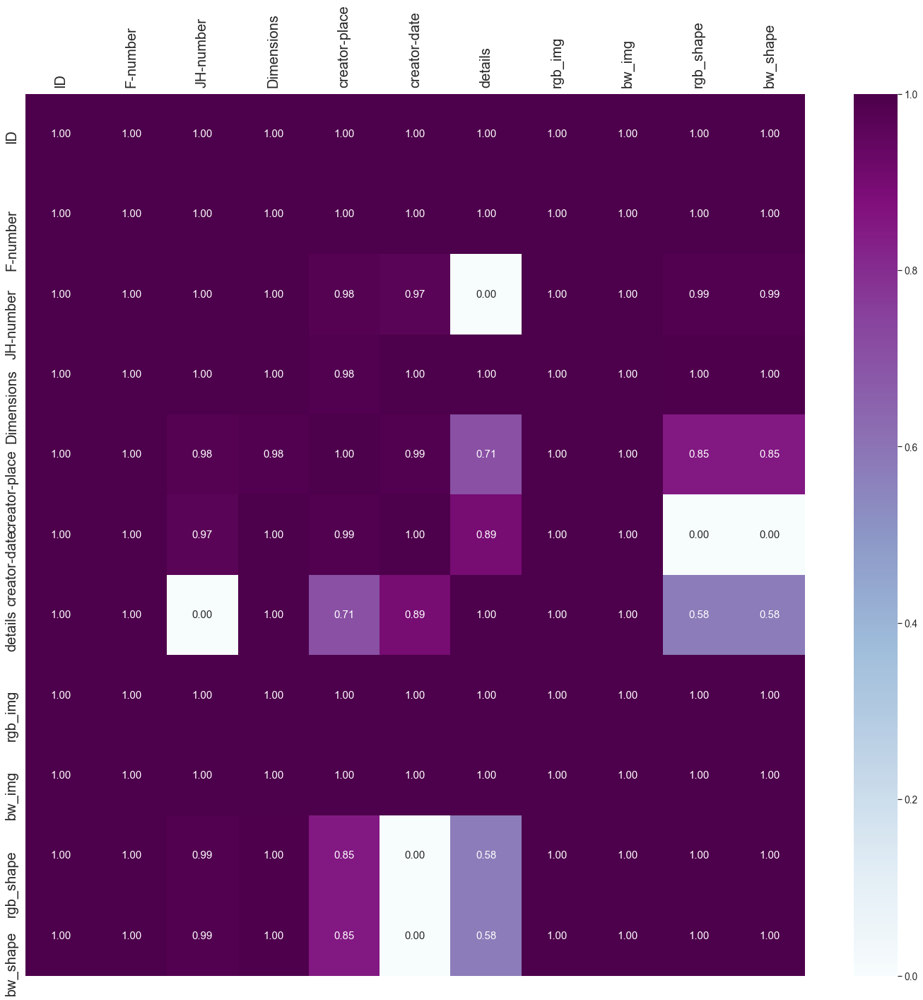

In [31]:
# rendering heatmap
fig, ax, heatmap = render_heatmap(phik_overview, (20, 20))
plt.show()

In [32]:
# saving rendered image
fig.savefig(img_fpn, dpi = fig.dpi)

In [33]:
#rendering conditional entropy
theilu_report = theilu_overview(train_df)

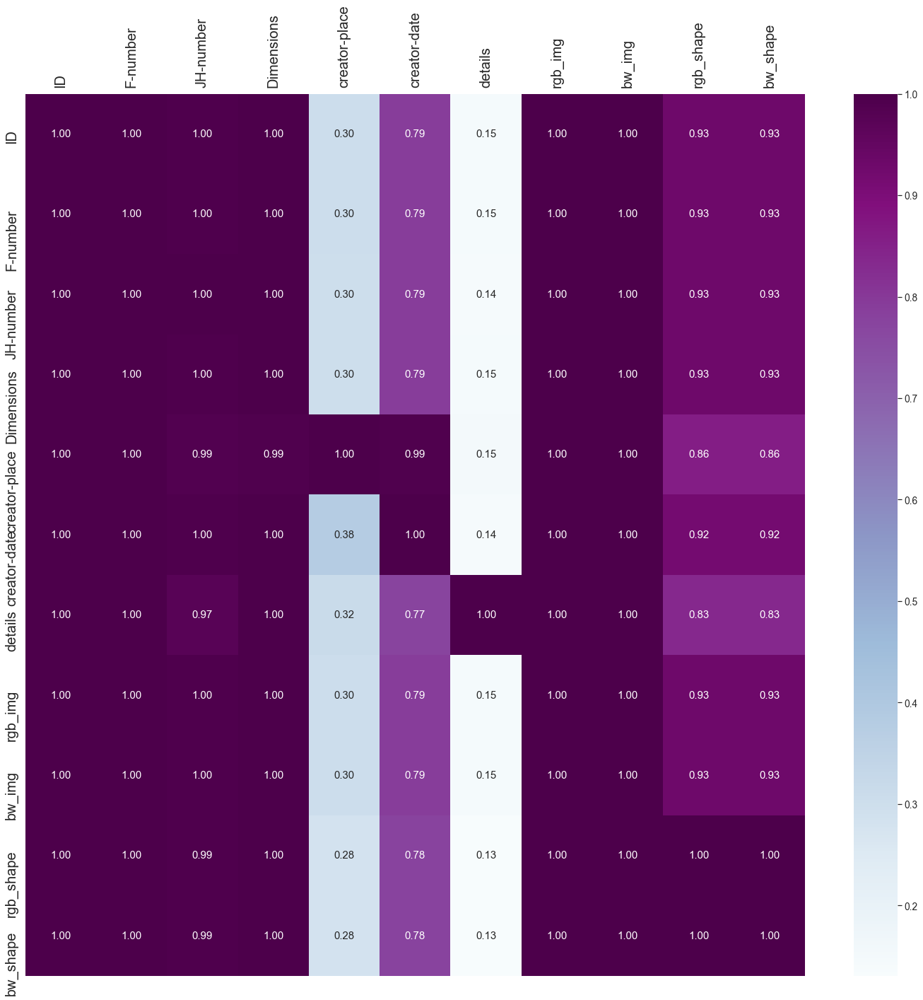

In [34]:
# rendering heatmap
fig, ax, heatmap = render_heatmap(theilu_report, (20, 20))
plt.show()

In [35]:
# saving image in png file
img_fpn = os.path.join(root_folder, dataf, reportf, work_coent_img)
img_fpn = img_fpn.replace(work_base, train_base)
print(os.path.exists(img_fpn))
print(img_fpn)

False
c:\Users\Felipe\Documents\GitHub\sa-artea\VVG-MLData-Preparer\Data\Reports\VVG-Gallery-Img-Train-Data-17-May-2021-coent.png


In [36]:
# saving rendered image
fig.savefig(img_fpn, dpi = fig.dpi)

In [37]:
cat_labels = ("creator-date", "creator-place", "Dimensions", "details")
target_df = pd.DataFrame(train_df)

for cat in cat_labels:

    # changing the type column to category
    tcol = target_df[cat].astype('category')
    target_df[cat] = tcol
    cat_count = len(tcol.cat.categories.values)

    # creating the category code column
    tcol = target_df[cat].cat.codes
    target_df[str("std_cat_" + cat)] = tcol
    tcol = target_df[str("std_cat_" + cat)]

    # creating the categry array for training
    cat_list = to_categorical(tcol, cat_count)
    target_df[str("std_cat_" + cat)] = cat_list.tolist()

In [38]:
target_df.head()

,ID,F-number,JH-number,Dimensions,creator-place,creator-date,details,rgb_img,bw_img,rgb_shape,bw_shape,std_cat_creator-date,std_cat_creator-place,std_cat_Dimensions,std_cat_details
0,s0005V1962,F0082,JH0764,"82 cm x 114 cm, 100 cm x 133 cm",nuenen,april-may 1885,oil on canvas,Data\Img\s0005V1962\vangoghmuseum-s0005V1962-8...,Data\Img\s0005V1962\vangoghmuseum-s0005V1962-8...,"[564, 800, 3]","[564, 800]","[0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
1,s0019V1962,F0314,JH1258,"75.0 cm x 113.0 cm, 95.0 cm x 132.4 cm",paris,may 1887,oil on canvas,Data\Img\s0019V1962\vangoghmuseum-s0019V1962-8...,Data\Img\s0019V1962\vangoghmuseum-s0019V1962-8...,"[537, 800, 3]","[537, 800]","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
2,s0022V1962,F0522,JH1356,"65.1 cm x 50 cm, 86 cm x 71 cm",paris,december 1887-february 1888,oil on canvas,Data\Img\s0022V1962\vangoghmuseum-s0022V1962-8...,Data\Img\s0022V1962\vangoghmuseum-s0022V1962-8...,"[800, 608, 3]","[800, 608]","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
3,s0027V1962,F0400,JH1371,"59.6 cm x 73.6 cm, 77.1 cm x 91.0 cm",arles,march 1888,oil on canvas,Data\Img\s0027V1962\vangoghmuseum-s0027V1962-8...,Data\Img\s0027V1962\vangoghmuseum-s0027V1962-8...,"[651, 800, 3]","[651, 800]","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
4,s0029V1962,F0451,JH1629,"32.5 cm x 40.3 cm, 58.5 cm x 56.5 cm",arles,november 1888,oil on canvas,Data\Img\s0029V1962\vangoghmuseum-s0029V1962-8...,Data\Img\s0029V1962\vangoghmuseum-s0029V1962-8...,"[643, 800, 3]","[643, 800]","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."


In [39]:
# saving the CSV file into pandas
# writing an existing CSV fileto update the dataframe
target_fn = "std-" + work_fn
fn_tpath = os.path.join(root_folder, dataf, stdf, target_fn)
print(fn_tpath)
target_df.to_csv(fn_tpath,
                sep=",",
                index=False,
                encoding="utf-8",
                mode="w",
                )

c:\Users\Felipe\Documents\GitHub\sa-artea\VVG-MLData-Preparer\Data\Std\std-VVG-Gallery-Img-Data-Paintings.csv
